In [1]:
!pip install -U ultralytics
!pip install --quiet --upgrade numpy==1.26.4 scipy==1.13.1

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 3.3 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of mkl-fft to determine which version is compatible with other requirements. This could take a while.
INFO: pip is looking at multiple versions of mkl-random to determine which version is compatible with other requirements. This could take a while.
INFO: pip is looking at multiple versions of mkl-umath to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 17.6 MB/s eta 0:00:0000:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.8/16.8 MB 76.7 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.1 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 83.6 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 63.9 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [2]:
import pandas as pd
from ultralytics import YOLO
from ultralytics import RTDETR
import matplotlib.pyplot as plt
import cv2

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [3]:
model = YOLO('/kaggle/input/yolov8s/keras/default/1/YOLOV8s_best.pt')


image 1/1 /kaggle/input/egypt-test/Cover-Photo-2.jpg: 448x640 15 Cars, 1 Pedestrian, 436.5ms
Speed: 14.5ms preprocess, 436.5ms inference, 24.9ms postprocess per image at shape (1, 3, 448, 640)


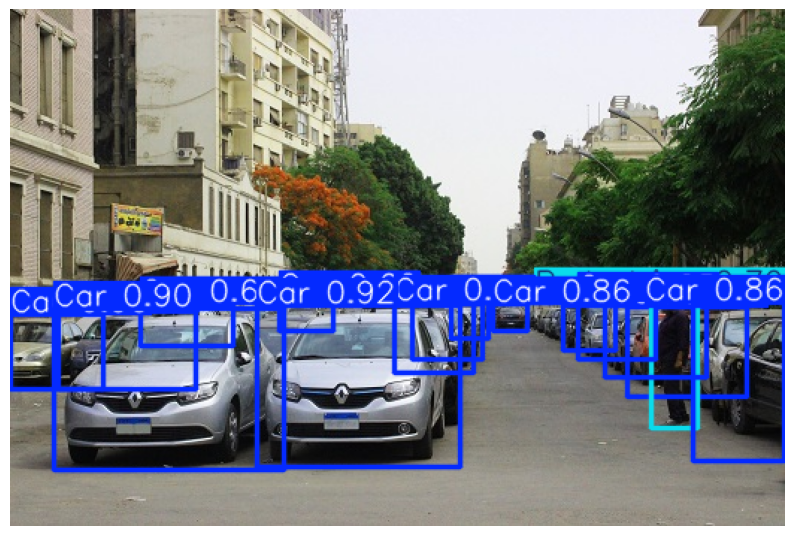

In [4]:
results = model.predict('/kaggle/input/egypt-test/Cover-Photo-2.jpg', save=False, conf=0.5)
result_img = results[0].plot()

result_img_rgb = cv2.cvtColor(result_img, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(10, 8))
plt.imshow(result_img_rgb)
plt.axis('off')
plt.show()

In [5]:
from IPython.display import Video

model.predict(
    source='/kaggle/input/driving-video/00054602-3bf57337.mov',
    conf=0.5,
    save=True,
    project='runs/video_preds',
    name='egypt_cars',
    device=0
)


WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/1223) /kaggle/input/driving-video/00054602-3bf57337.mov: 384x640 2 Cars, 1 Pedestrian, 1 Truck, 291.6ms
video 1/1 (frame 2/1223) /kaggle/input/driving-video/00054602-3bf57337.mov: 384x640 2 Cars, 1 Pedestrian, 1 Truck, 262.1ms
video 1/1 (frame 3/1223) /kaggle/input/driving-video/00054602-3bf57337.mov: 384x640 2 Cars, 1 Pedestrian, 1 Truck, 261.2ms
video 1/1 (frame 4/1223) /kaggle/input/driving-video/00054602-3bf57337.mov: 384x640 2 C

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'Car', 1: 'Pedestrian', 2: 'Van', 3: 'Cyclist', 4: 'Truck', 5: 'Misc', 6: 'Tram', 7: 'Person_sitting'}
 obb: None
 orig_img: array([[[210, 139,  66],
         [210, 139,  66],
         [210, 139,  66],
         ...,
         [147, 123, 111],
         [154, 138, 104],
         [170, 154, 120]],
 
        [[210, 139,  66],
         [210, 139,  66],
         [210, 139,  66],
         ...,
         [166, 142, 130],
         [159, 143, 109],
         [167, 151, 117]],
 
        [[210, 139,  66],
         [210, 139,  66],
         [210, 139,  66],
         ...,
         [168, 144, 132],
         [159, 143, 109],
         [167, 151, 117]],
 
        ...,
 
        [[ 59,  42,  29],
         [ 59,  42,  29],
         [ 61,  44,  31],
         ...,
         [  9,   4,   3],
         [  9,   4,   3],
         [  9,   4,   3]],
 
        [[ 40,  4

In [6]:
!ffmpeg -i /kaggle/working/runs/video_preds/egypt_cars/00054602-3bf57337.avi \
       -vcodec libx264 /kaggle/working/egypt_cars_video.mp4 -y

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [7]:
from IPython.display import HTML
from base64 import b64encode

video_path = '/kaggle/working/egypt_cars_video.mp4'

mp4 = open(video_path, 'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML(f"""
<video width=800 controls>
    <source src="{data_url}" type="video/mp4">
</video>
""")